In [1]:
# Make sure you are using the cmpi6-2019.10 kernel

# Add ldcpy root to system path (MODIFY FOR YOUR LDCPY CODE LOCATION)
import sys

sys.path.insert(0, '/glade/u/home/abaker/repos/ldcpy')
import ldcpy

# Display output of plots directly in Notebook
%matplotlib inline
# Automatically reload module if it is editted
%reload_ext autoreload
%autoreload 2

# silence warnings
import warnings

warnings.filterwarnings("ignore")

Start DASK...and connect to client

In [2]:
from dask.distributed import Client
from ncar_jobqueue import NCARCluster

cluster = NCARCluster(project='NTDD0004')
# scale as needed
cluster.adapt(minimum_jobs=1, maximum_jobs=30)
cluster
client = Client(cluster)

In [3]:
ts_test = ldcpy.open_datasets("cam-fv",["TS"],
                                 ["/glade/scratch/abaker/comp/orig/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc", 
                                   "/glade/scratch/abaker/comp4nc_zfp/zfp_p_16/TS.zfp_all.nc",
                                   "/glade/scratch/abaker/comp4nc_zfp_un/zfp_p_16/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc"], 
                                 ["orig", "zfp_all_p16", "zfp_p16_un"])
    

dataset size in GB 0.04



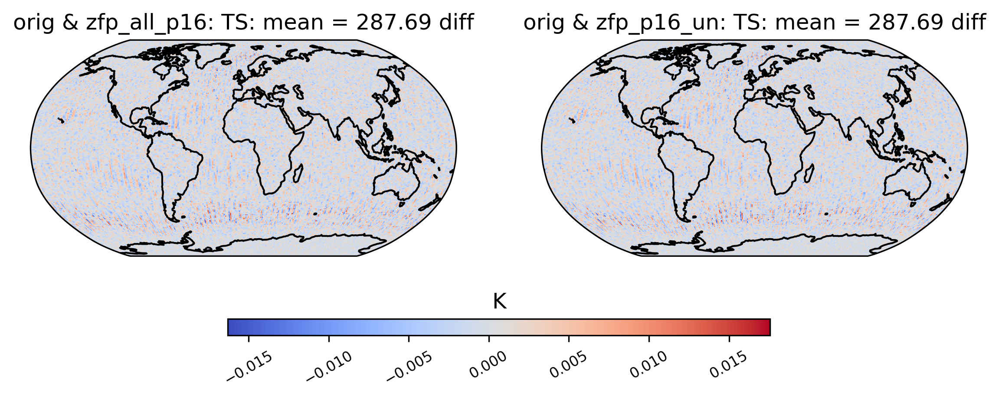

In [4]:
# diff between mean
ldcpy.plot(
    ts_test,
    "TS",
    sets=["orig", "zfp_all_p16", "zfp_p16_un"],
    calc="mean",
    calc_type="diff",
)

In [6]:
ldcpy.compare_stats(
    ts_test.isel(time=10),
    "TS",
    [
        "orig",
        "zfp_all_p16","zfp_p16_un"
    ]
)

,orig,zfp_all_p16,zfp_p16_un
mean,286.58,286.58,286.58
variance,501.42,501.42,501.42
standard deviation,22.392,22.392,22.392
min value,224.47,224.46,224.46
max value,310.34,310.33,310.33
probability positive,1,1,1
number of zeros,0,0,0
spatial autocorr - latitude,0.99554,0.99554,0.99554
spatial autocorr - longitude,0.99824,0.99824,0.99824
entropy estimate,0.4065,0.22836,0.22836


,zfp_all_p16,zfp_p16_un
max abs diff,0.054474,0.054474
min abs diff,0,0
mean abs diff,0.013445,0.013445
mean squared diff,4.8251e-09,4.8251e-09
root mean squared diff,0.016758,0.016758
normalized root mean squared diff,0.00018335,0.00018335
normalized max pointwise error,0.00063438,0.00063438
pearson correlation coefficient,1,1
ks p-value,1,1
spatial relative error(% > 0.0001),7.8487,7.8487


In [ ]:
col2_zfp = ldcpy.open_datasets("cam-fv",["TS"],
                                 ["/glade/p/cisl/asap/CAM_lossy_test_data_31/orig/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc",
                                   "/glade/p/cisl/asap/CAM_lossy_test_data_31/research/zfp_all/zfp_p_16/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc",
                                   "/glade/scratch/abaker/comp4nc_zfp_un/zfp_p_16.0/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc"], 
                                 ["orig", "zfp_all_p16", "zfp_p16_new"])
    

In [ ]:
# diff between mean
ldcpy.plot(
    col2_zfp,
    "TS",
    sets=["orig", "zfp_all_p16", "zfp_p16_new"],
    calc="mean",
    calc_type="diff",
)

In [3]:
col_ts_sz = ldcpy.open_datasets("cam-fv",["TS"],
                                 ["/glade/scratch/abaker/carleton/orig/b.e11.B20TRC5CNBDRD.f09_g16.030.cam.h1.TS.19200101-20051231.nc",
                                  "/glade/scratch/abaker/carleton/prev/szAOn0.01/b.e11.B20TRC5CNBDRD.f09_g16.030.cam.h1.TS.19200101-20051231.nc",
                                  "/glade/scratch/abaker/carleton/new/sz2_1_12AOn0.01/b.e11.B20TRC5CNBDRD.f09_g16.030.cam.h1.TS.19200101-20051231.nc"],
                                
                                 ["orig", "sz_prev", "sz_new"])

dataset size in GB 20.83



In [3]:
ts_new_sz_col_01 = ldcpy.open_datasets("cam-fv", ["TS"], 
                                 ["/glade/p/cisl/asap/CAM_lossy_test_data_31/orig/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc",
                                  "/glade/scratch/abaker/sz3/sz3ROn0.01/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc",
                                  "/glade/p/cisl/asap/CAM_lossy_test_data_31/research/sz2.1.12/sz2_1_12ROn0.01/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc",
                                  "/glade/p/cisl/asap/CAM_lossy_test_data_31/research/sz1.4.13.true/sz1ROn0.01/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc"],
                                 ["orig", "sz3_01", "sz2_01", "sz1_01"]
                                )

dataset size in GB 0.05



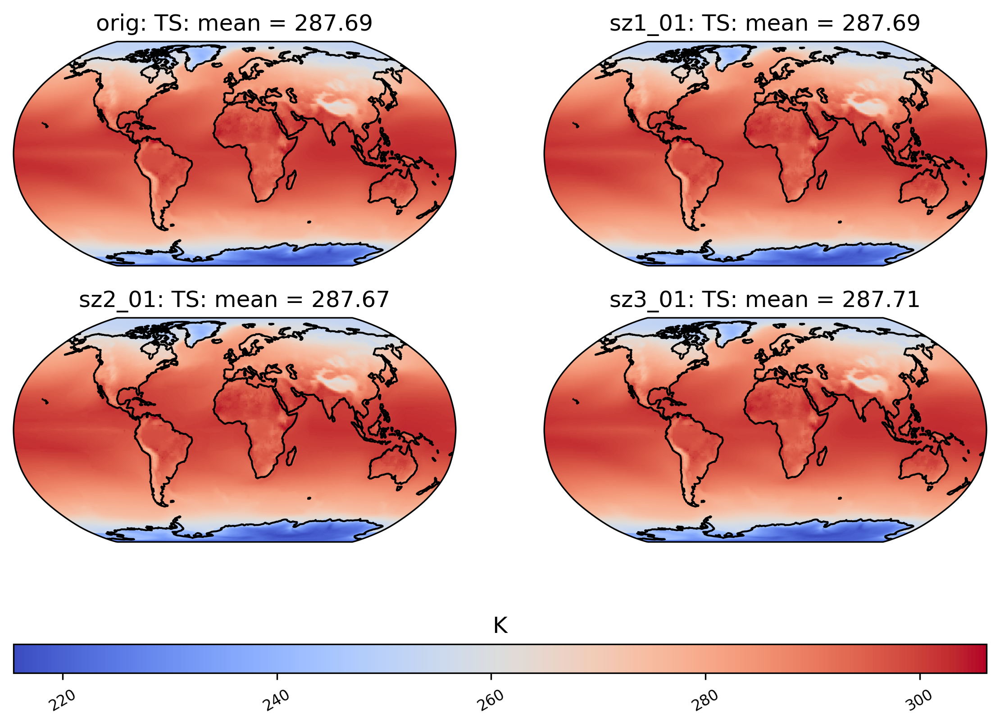

In [5]:
# mean
ldcpy.plot(
    ts_new_sz_col_01,
    "TS",
    sets=["orig", "sz1_01", "sz2_01", "sz3_01"],
    calc="mean")

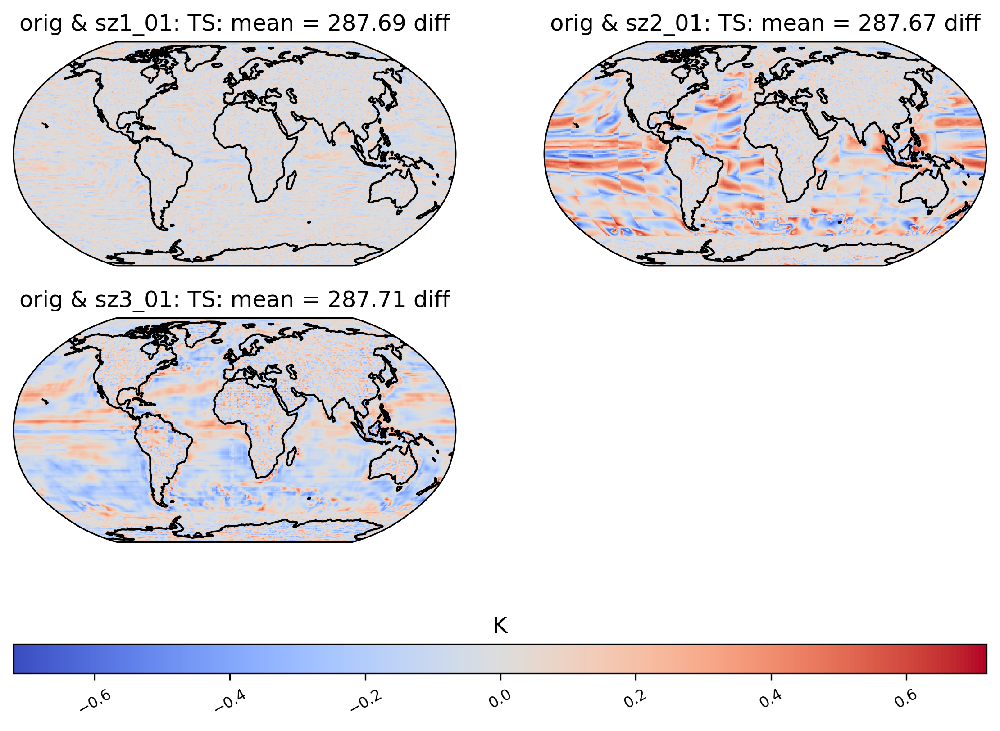

In [13]:
# diff between mean
ldcpy.plot(
    ts_new_sz_col_01,
    "TS",
    sets=["orig", "sz1_01", "sz2_01", "sz3_01"],
    calc="mean",
    calc_type="diff",
)

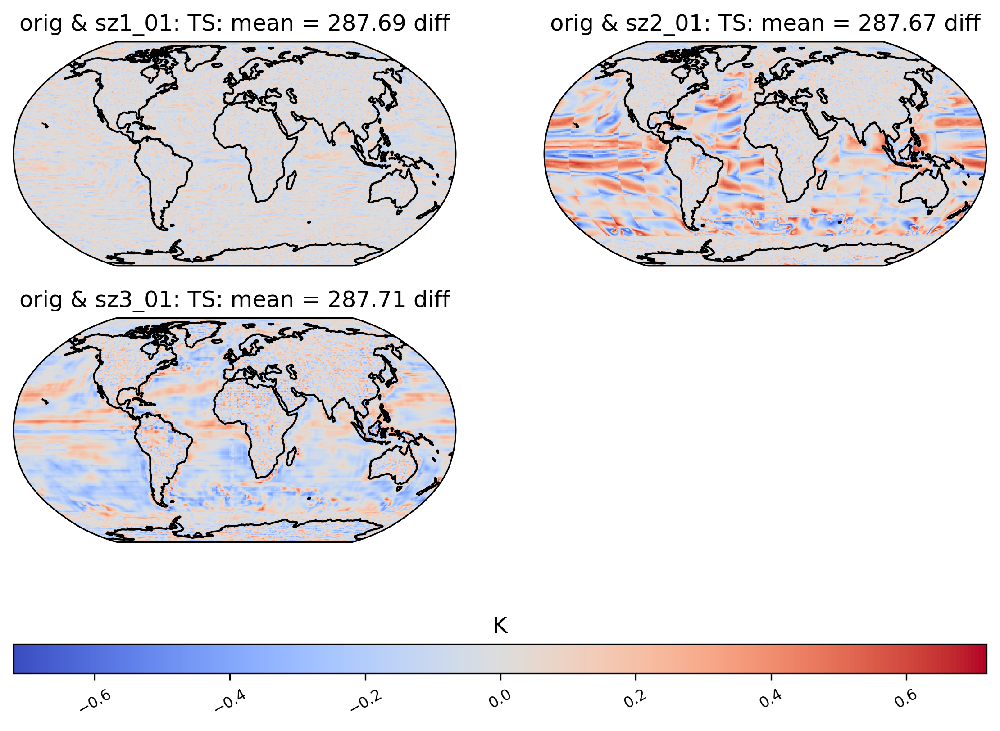

In [14]:
# diff between mean
ldcpy.plot(
    ts_new_sz_col_01,
    "TS",
    sets=["orig", "sz1_01", "sz2_01", "sz3_01"],
    calc="mean",
    calc_type="diff",
)

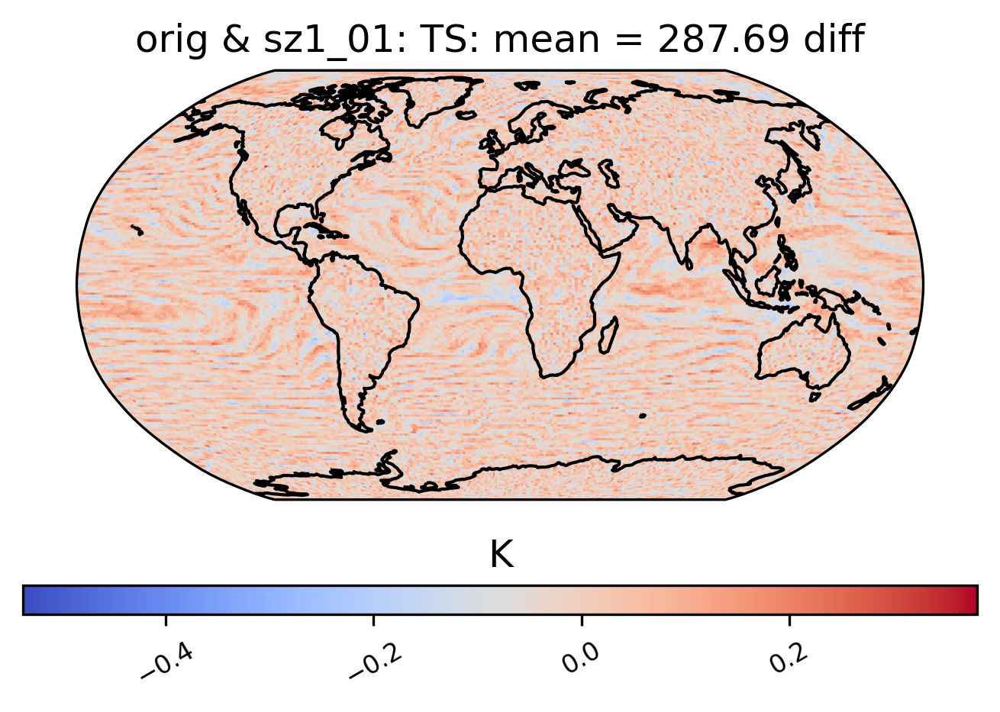

In [15]:
# diff between mean
ldcpy.plot(
    ts_new_sz_col_01,
    "TS",
    sets=["orig", "sz1_01"],
    calc="mean",
    calc_type="diff",
)

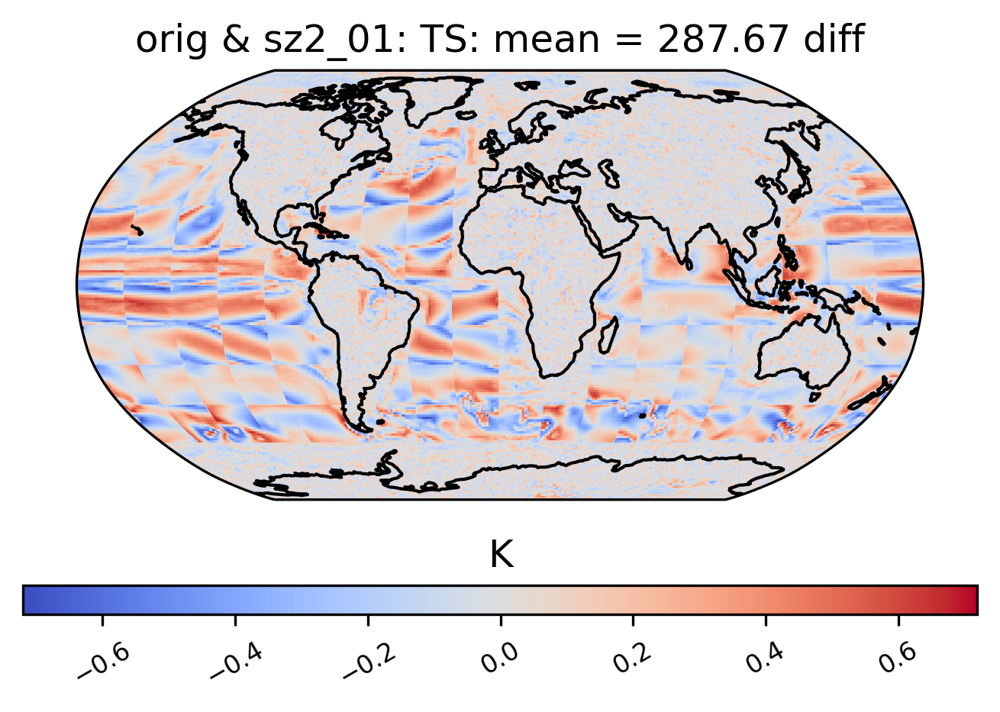

In [16]:
# diff between mean
ldcpy.plot(
    ts_new_sz_col_01,
    "TS",
    sets=["orig", "sz2_01"],
    calc="mean",
    calc_type="diff",
)

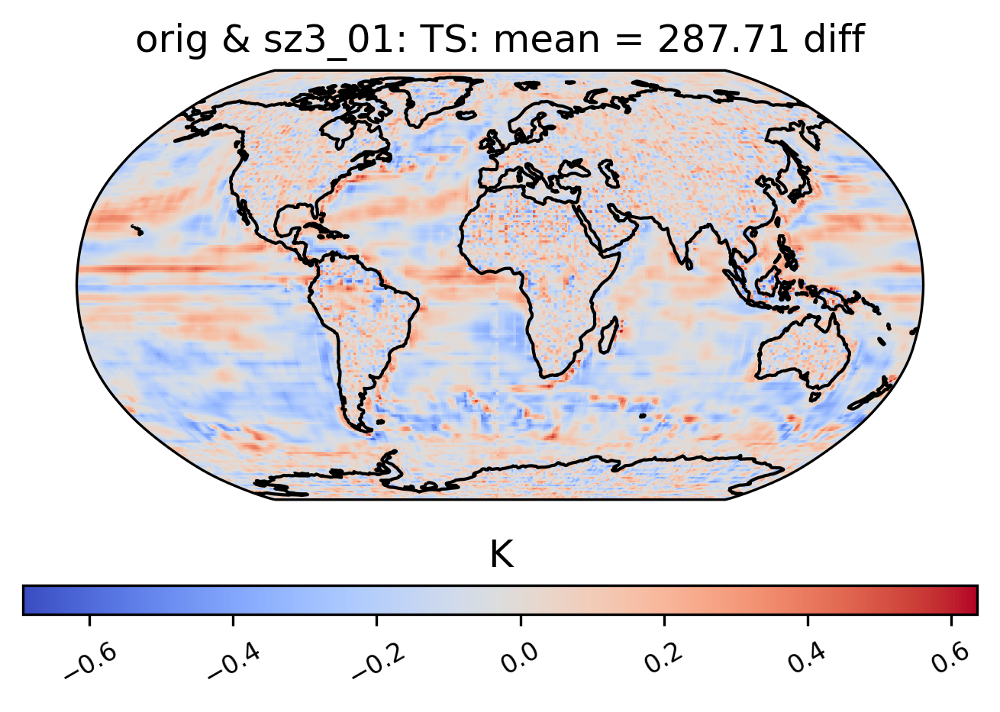

In [8]:
# diff between mean
ldcpy.plot(
    ts_new_sz_col_01,
    "TS",
    sets=["orig", "sz3_01"],
    calc="mean",
    calc_type="diff",
)

In [9]:
ldcpy.compare_stats(
    ts_new_sz_col_01.isel(time=3),
    "TS",
    [
        "orig",
        "sz1_01","sz2_01", "sz3_01"
        
    ]
)

,orig,sz1_01,sz2_01,sz3_01
mean,287.7,287.72,287.68,287.7
variance,611.01,611.6,611.03,610.49
standard deviation,24.719,24.731,24.719,24.708
min value,204.35,204.75,205.3,203.53
max value,310.67,311.06,311.52,311.33
probability positive,1,1,1,1
number of zeros,0,0,0,0
spatial autocorr - latitude,0.99671,0.99615,0.99632,0.99646
spatial autocorr - longitude,0.99903,0.99869,0.99872,0.99884
entropy estimate,0.40394,0.1832,0.27722,0.40501


,sz1_01,sz2_01,sz3_01
max abs diff,1.0632,1.0636,1.2118
min abs diff,3.0518e-05,0,0
mean abs diff,0.53298,0.44957,0.43818
mean squared diff,0.00047389,0.00022247,2.719e-09
root mean squared diff,0.61444,0.54109,0.53688
normalized root mean squared diff,0.0057739,0.0052611,0.0051821
normalized max pointwise error,0.0099996,0.010003,0.011398
pearson correlation coefficient,0.99969,0.99974,0.99975
ks p-value,1.2657e-69,0.029257,0.0016592
spatial relative error(% > 0.0001),97.41,96.309,96.092


In [10]:
ts_new_sz_col_001 = ldcpy.open_datasets("cam-fv", ["TS"], 
                                 ["/glade/p/cisl/asap/CAM_lossy_test_data_31/orig/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc",
                                  "/glade/scratch/abaker/sz3/sz3ROn0.001/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc",
                                  "/glade/p/cisl/asap/CAM_lossy_test_data_31/research/sz2.1.12/sz2_1_12ROn0.001/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc",
                                  "/glade/p/cisl/asap/CAM_lossy_test_data_31/research/sz1.4.13.true/sz1ROn0.001/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc"],
                                 ["orig", "sz3_001", "sz2_001", "sz1_001"]
                                )

dataset size in GB 0.05



In [11]:
ldcpy.compare_stats(
    ts_new_sz_col_001.isel(time=3),
    "TS",
    [
        "orig",
        "sz1_001","sz2_001", "sz3_001"
        
    ]
)

,orig,sz1_001,sz2_001,sz3_001
mean,287.7,287.7,287.7,287.7
variance,611.01,611.02,610.98,610.98
standard deviation,24.719,24.719,24.718,24.718
min value,204.35,204.41,204.41,204.24
max value,310.67,310.76,310.73,310.67
probability positive,1,1,1,1
number of zeros,0,0,0,0
spatial autocorr - latitude,0.99671,0.99671,0.9967,0.9967
spatial autocorr - longitude,0.99903,0.99902,0.99902,0.99902
entropy estimate,0.40394,0.35689,0.3034,0.22318


,sz1_001,sz2_001,sz3_001
max abs diff,0.10631,0.14963,0.12119
min abs diff,0,0,0
mean abs diff,0.052853,0.053459,0.060137
mean squared diff,3.4332e-09,8.6781e-08,4.3839e-08
root mean squared diff,0.061078,0.061858,0.069563
normalized root mean squared diff,0.00057484,0.00058117,0.00065562
normalized max pointwise error,0.0009999,0.0012145,0.0011398
pearson correlation coefficient,1,1,1
ks p-value,0.98121,0.88797,0.53785
spatial relative error(% > 0.0001),73.522,73.873,76.915


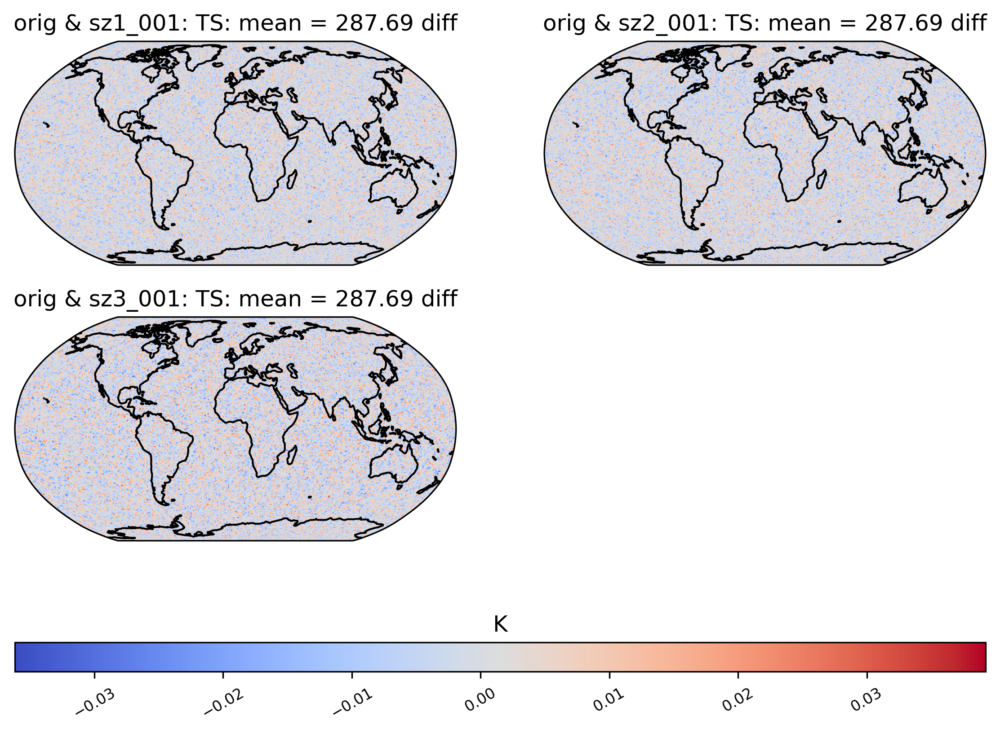

In [12]:
# diff between mean
ldcpy.plot(
    ts_new_sz_col_001,
    "TS",
    sets=["orig", "sz1_001", "sz2_001", "sz3_001"],
    calc="mean",
    calc_type="diff",
)

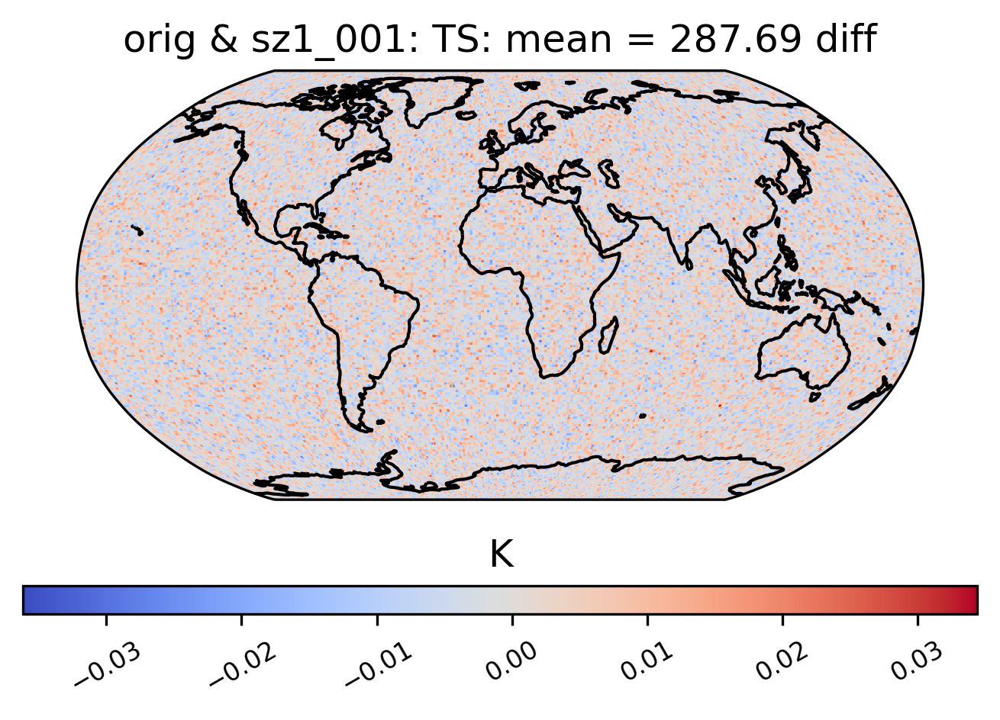

In [17]:
# diff between mean
ldcpy.plot(
    ts_new_sz_col_001,
    "TS",
    sets=["orig", "sz1_001"],
    calc="mean",
    calc_type="diff",
)

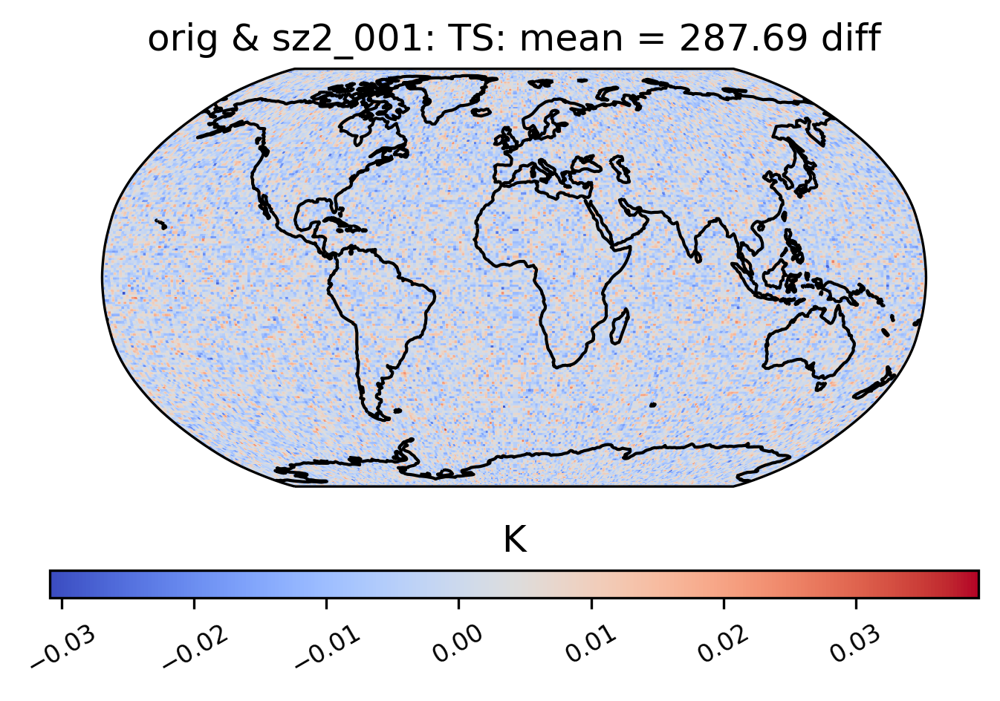

In [18]:
# diff between mean
ldcpy.plot(
    ts_new_sz_col_001,
    "TS",
    sets=["orig", "sz2_001"],
    calc="mean",
    calc_type="diff",
)

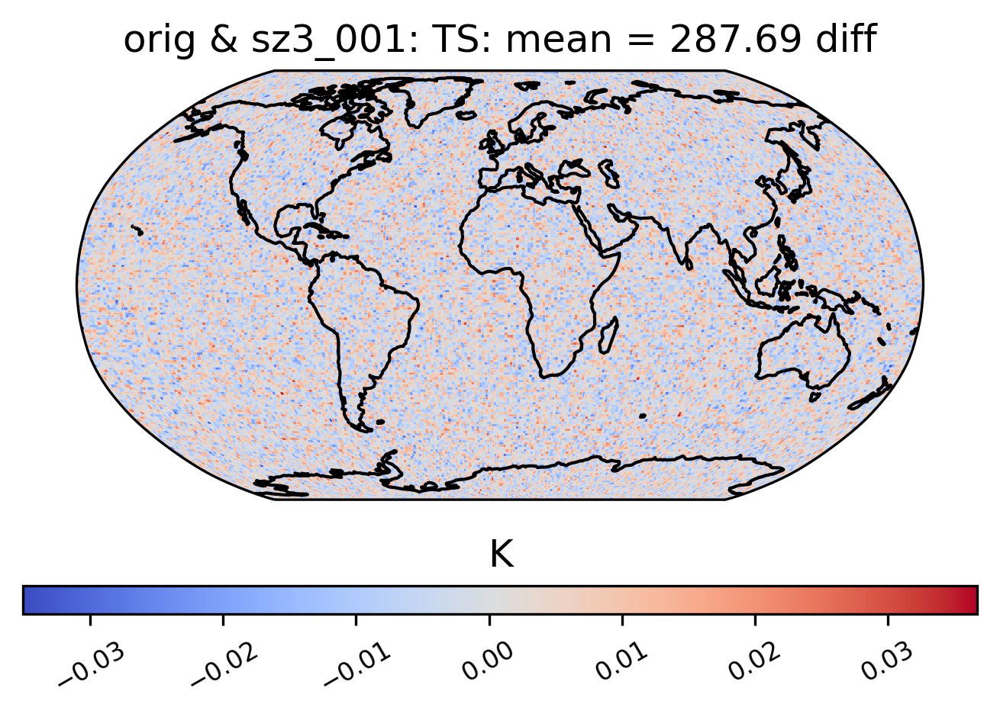

In [19]:
# diff between mean
ldcpy.plot(
    ts_new_sz_col_001,
    "TS",
    sets=["orig", "sz3_001"],
    calc="mean",
    calc_type="diff",
)

In [20]:
ts_new_sz_col_1 = ldcpy.open_datasets("cam-fv", ["TS"], 
                                 ["/glade/p/cisl/asap/CAM_lossy_test_data_31/orig/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc",
                                  "/glade/scratch/abaker/sz3/sz3ROn0.1/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc",
                                  "/glade/p/cisl/asap/CAM_lossy_test_data_31/research/sz2.1.12/sz2_1_12ROn0.1/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc",
                                  "/glade/p/cisl/asap/CAM_lossy_test_data_31/research/sz1.4.13.true/sz1ROn0.1/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc"],
                                 ["orig", "sz3_1", "sz2_1", "sz1_1"]
                                )

dataset size in GB 0.05



In [21]:
ldcpy.compare_stats(
    ts_new_sz_col_1.isel(time=3),
    "TS",
    [
        "orig",
        "sz1_1","sz2_1", "sz3_1"
        
    ]
)

,orig,sz1_1,sz2_1,sz3_1
mean,287.7,289.21,287.67,287.56
variance,611.01,681.32,605.27,509.01
standard deviation,24.719,26.102,24.602,22.561
min value,204.35,196.24,196.42,194.45
max value,310.67,302.56,320.55,321.91
probability positive,1,1,1,1
number of zeros,0,0,0,0
spatial autocorr - latitude,0.99671,0.98299,0.99497,0.9952
spatial autocorr - longitude,0.99903,0.99277,0.99814,0.99827
entropy estimate,0.40394,0.060468,0.15119,0.40179


,sz1_1,sz2_1,sz3_1
max abs diff,10.632,10.629,12.116
min abs diff,0.00061035,1.5259e-05,0.0002594
mean abs diff,4.6088,1.3252,2.6325
mean squared diff,2.2795,0.00066999,0.018672
root mean squared diff,5.5454,2.1372,3.3226
normalized root mean squared diff,0.055124,0.023062,0.039423
normalized max pointwise error,0.09999,0.099963,0.11393
pearson correlation coefficient,0.97568,0.99507,0.98924
ks p-value,0,1.4855e-08,1.236e-114
spatial relative error(% > 0.0001),99.66,97.975,99.452


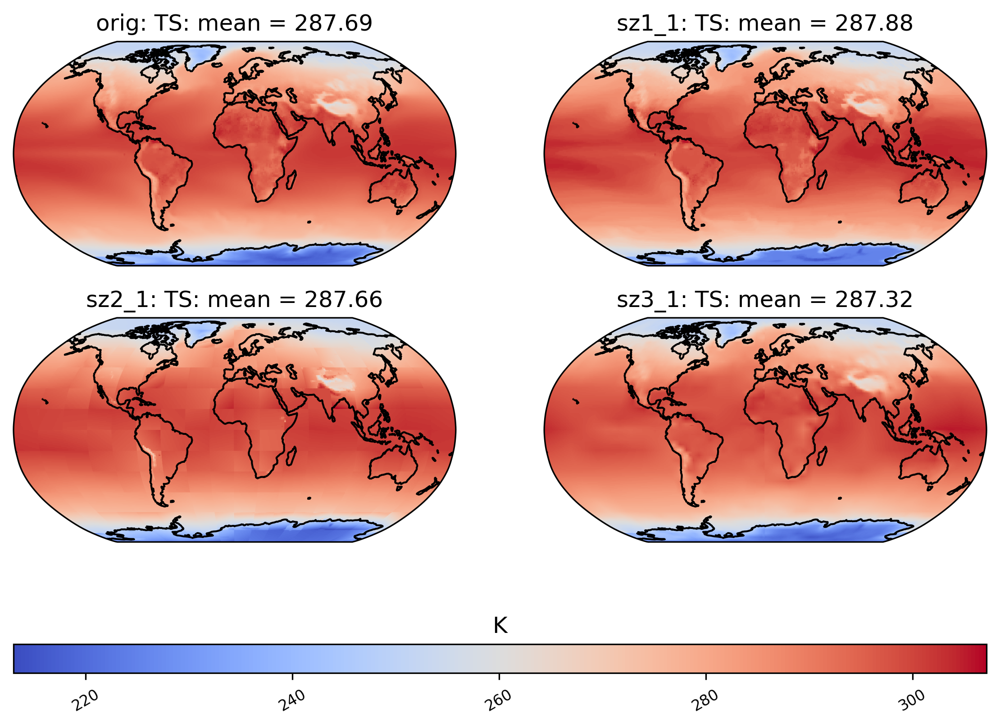

In [27]:
ldcpy.plot(
    ts_new_sz_col_1,
    "TS",
    sets=["orig", "sz1_1", "sz2_1", "sz3_1"],
    calc="mean",
)

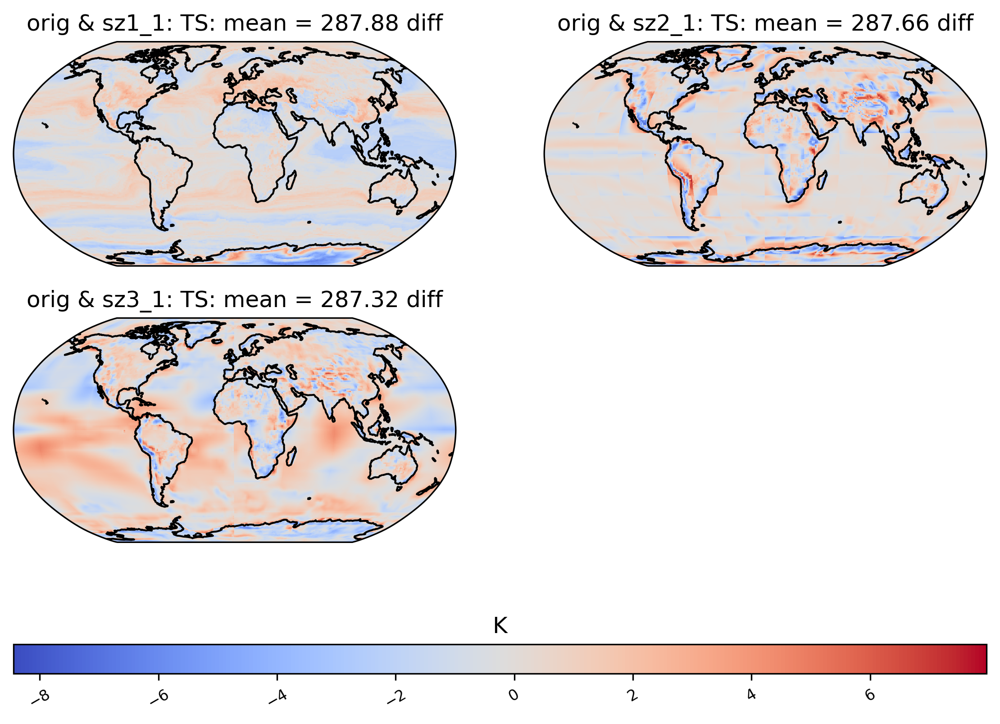

In [22]:
# diff between mean
ldcpy.plot(
    ts_new_sz_col_1,
    "TS",
    sets=["orig", "sz1_1", "sz2_1", "sz3_1"],
    calc="mean",
    calc_type="diff",
)

In [23]:
ts_new_sz_col_0001 = ldcpy.open_datasets("cam-fv", ["TS"], 
                                 ["/glade/p/cisl/asap/CAM_lossy_test_data_31/orig/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc",
                                  "/glade/scratch/abaker/sz3/sz3ROn0.0001/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc",
                                  "/glade/p/cisl/asap/CAM_lossy_test_data_31/research/sz2.1.12/sz2_1_12ROn0.0001/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc",
                                  "/glade/p/cisl/asap/CAM_lossy_test_data_31/research/sz1.4.13.true/sz1ROn0.0001/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc"],
                                 ["orig", "sz3_0001", "sz2_0001", "sz1_0001"]
                                )

dataset size in GB 0.05



In [24]:
ldcpy.compare_stats(
    ts_new_sz_col_0001.isel(time=3),
    "TS",
    [
        "orig",
        "sz1_0001","sz2_0001", "sz3_0001"
        
    ]
)

,orig,sz1_0001,sz2_0001,sz3_0001
mean,287.7,287.7,287.7,287.7
variance,611.01,611.01,611.05,611.01
standard deviation,24.719,24.719,24.719,24.719
min value,204.35,204.35,204.35,204.34
max value,310.67,310.67,310.67,310.66
probability positive,1,1,1,1
number of zeros,0,0,0,0
spatial autocorr - latitude,0.99671,0.99671,0.99671,0.99671
spatial autocorr - longitude,0.99903,0.99903,0.99903,0.99903
entropy estimate,0.40394,0.40069,0.39338,0.40079


,sz1_0001,sz2_0001,sz3_0001
max abs diff,0.01062,0.064789,0.012115
min abs diff,0,0,0
mean abs diff,0.0052982,0.0066155,0.0060513
mean squared diff,8.1757e-10,6.7957e-07,2.0711e-09
root mean squared diff,0.0061267,0.0094397,0.0069893
normalized root mean squared diff,5.7608e-05,0.0001107,6.5745e-05
normalized max pointwise error,9.9889e-05,0.00060938,0.00011395
pearson correlation coefficient,1,1,1
ks p-value,1,1,1
spatial relative error(% > 0.0001),0,4.8937,0


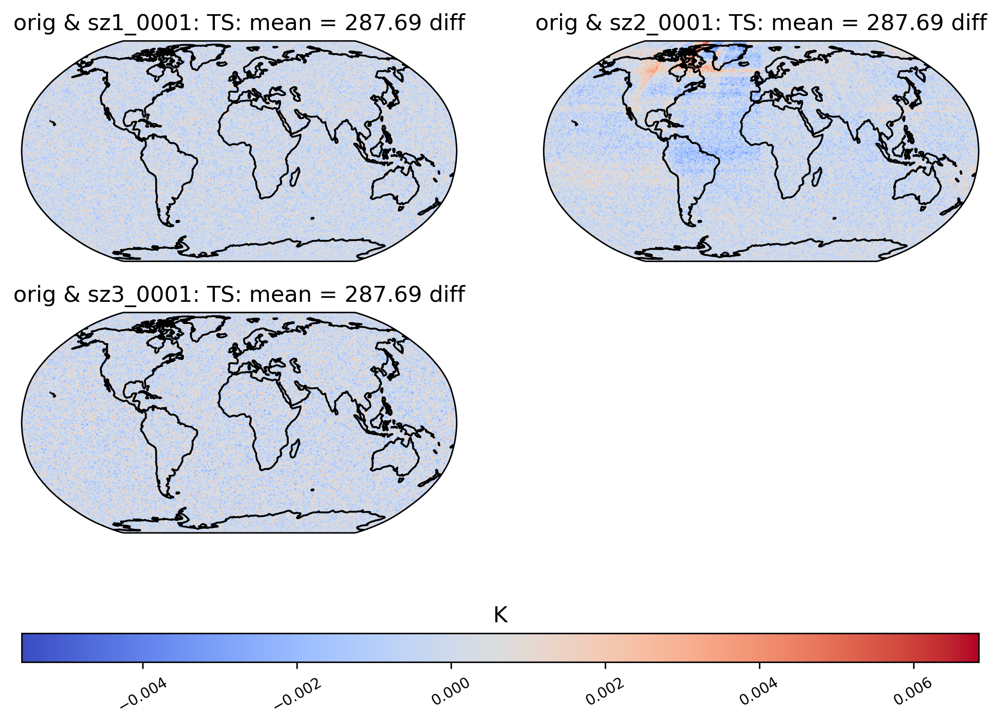

In [26]:
# diff between mean
ldcpy.plot(
    ts_new_sz_col_0001,
    "TS",
    sets=["orig", "sz1_0001", "sz2_0001", "sz3_0001"],
    calc="mean",
    calc_type="diff",
)

In [7]:
prect_new_sz_col = ldcpy.open_datasets("cam-fv", ["PRECT"], 
                                 ["/glade/p/cisl/asap/CAM_lossy_test_data_31/orig/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
                                  "/glade/scratch/abaker/sz3/sz3ROn0.1/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
                                  "/glade/scratch/abaker/sz3/sz3ROn0.01/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
                                  "/glade/scratch/abaker/sz3/sz3ROn0.001/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
                                  "/glade/scratch/abaker/sz3/sz3ROn0.0001/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
                                  "/glade/scratch/abaker/sz3/sz3ROn0.00001/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
                                 ],
                                 ["orig", "sz3_1", "sz3_01", "sz3_001", "sz3_0001", "sz3_00001"]
                                )

dataset size in GB 0.97



In [9]:
ldcpy.compare_stats(
    prect_new_sz_col.isel(time=3),
    "PRECT",
    [
        "orig",
        "sz3_1", "sz3_01","sz3_001", "sz3_0001", "sz3_00001"
        
    ]
)

,orig,sz3_1,sz3_01,sz3_001,sz3_0001,sz3_00001
mean,3.6206e-08,3.0838e-08,3.7706e-08,3.6305e-08,3.6207e-08,3.6206e-08
variance,3.3017e-15,3.6804e-15,3.3896e-15,3.299e-15,3.3015e-15,3.3017e-15
standard deviation,5.746e-08,6.0667e-08,5.822e-08,5.7437e-08,5.7459e-08,5.746e-08
min value,-4.102e-25,-4.291e-07,-4.3257e-08,-4.2849e-09,-4.3242e-10,-4.3085e-11
max value,9.0443e-07,1.1813e-06,9.4757e-07,9.0866e-07,9.0424e-07,9.0444e-07
probability positive,0.99277,0.72459,0.84006,0.92799,0.9413,0.96173
number of zeros,398,712,339,0,0,0
spatial autocorr - latitude,0.88925,0.8815,0.86617,0.88816,0.88924,0.88925
spatial autocorr - longitude,0.92604,0.92797,0.90728,0.92519,0.92603,0.92604
entropy estimate,0.52952,0.42244,0.51972,0.53023,0.53205,0.53315


,sz3_1,sz3_01,sz3_001,sz3_0001,sz3_00001
max abs diff,4.323e-07,4.3315e-08,4.3316e-09,4.3316e-10,4.3315e-11
min abs diff,0,0,2.5951e-14,0,1.1174e-15
mean abs diff,3.9256e-08,1.2443e-08,1.7884e-09,2.0455e-10,2.1087e-11
mean squared diff,2.8806e-17,2.2522e-18,9.8897e-21,3.4289e-24,3.2974e-27
root mean squared diff,6.8409e-08,1.646e-08,2.1787e-09,2.4064e-10,2.4568e-11
normalized root mean squared diff,0.069131,0.017029,0.0023289,0.00026155,2.7064e-05
normalized max pointwise error,0.47798,0.047892,0.0047893,0.00047893,4.7892e-05
pearson correlation coefficient,0.44518,0.96493,0.99933,0.99999,1
ks p-value,0,0,3.9972e-125,2.934e-83,1.2968e-35
spatial relative error(% > 0.0001),99.278,99.273,99.215,98.597,92.625


In [4]:
# diff between mean
ldcpy.plot(
    col_ts_sz,
    "TS",
    sets=["orig", "sz_prev", "sz_new"],
    calc="mean",
    calc_type="diff",
)

KilledWorker: ("('open_dataset-86d2e4f0d094fe66dcde84277e17eb61TS-26b97a0eebb71c95c63b7889c416865e', 0, 0, 0)", <WorkerState 'tcp://10.148.7.159:46239', name: PBSCluster-0-17, memory: 0, processing: 1>)

In [ ]:
sm_col_ts_sz = ldcpy.open_datasets("cam-fv",["TS"],
                                 ["/glade/scratch/abaker/carleton/orig/ts.10.nc",
                                  "/glade/scratch/abaker/carleton/prev/szAOn0.01/ts.10.nc",
                                  "/glade/scratch/abaker/carleton/new/sz2_1_12AOn0.01/ts.10.nc",
                                 "/glade/scratch/abaker/carleton/sz1/sz1AOn0.01/ts.10.nc"],

                                 ["orig", "sz_prev", "sz_new","sz1"])

In [ ]:
ldcpy.compare_stats(
    sm_col_ts_sz.isel(time=3),
    "TS",
    [
        "orig",
        "sz_prev","sz_new", "sz1"
        
    ]
)

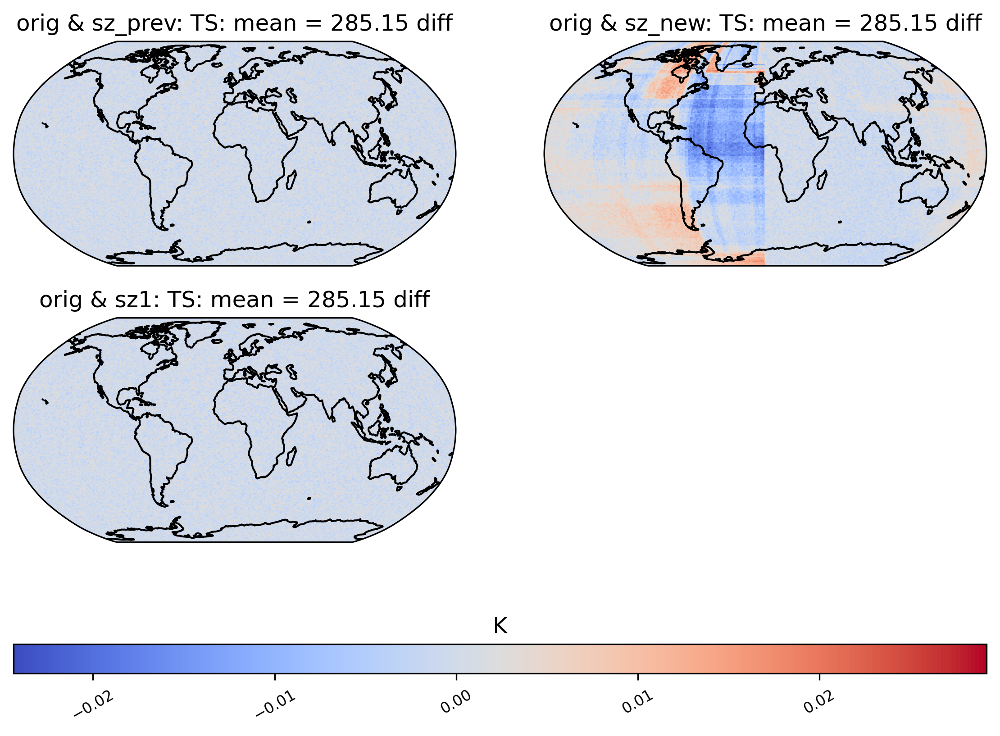

In [10]:
# diff between mean
ldcpy.plot(
    sm_col_ts_sz,
    "TS",
    sets=["orig", "sz_prev", "sz_new","sz1"],
    calc="mean",
    calc_type="diff",
)

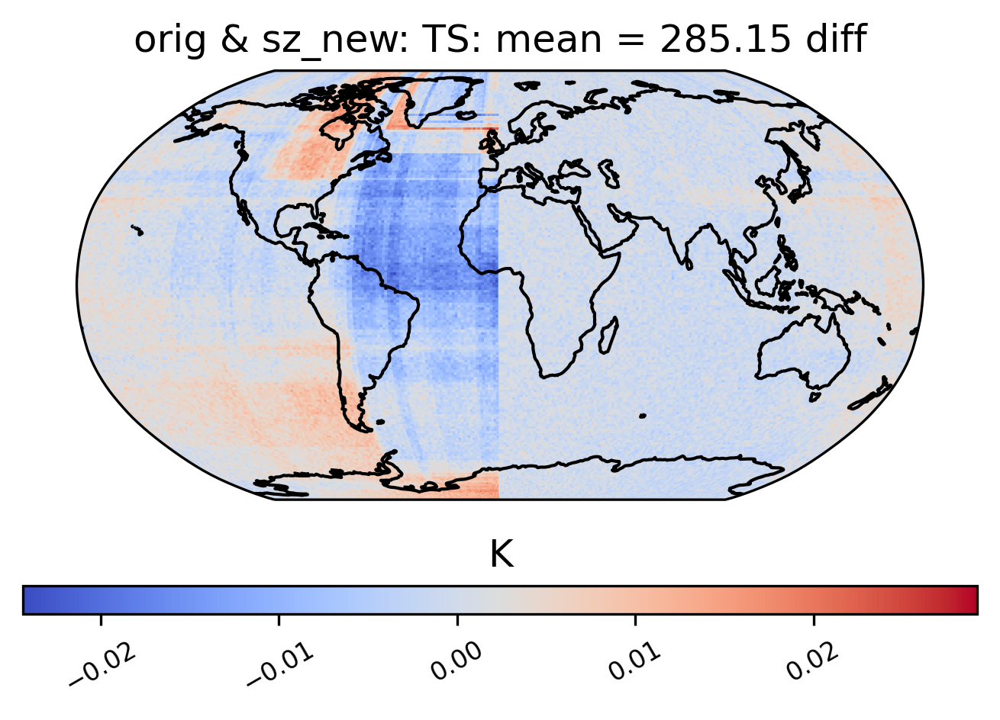

In [11]:
# diff between mean
ldcpy.plot(
    sm_col_ts_sz,
    "TS",
    sets=["orig", "sz_new"],
    calc="mean",
    calc_type="diff",
)

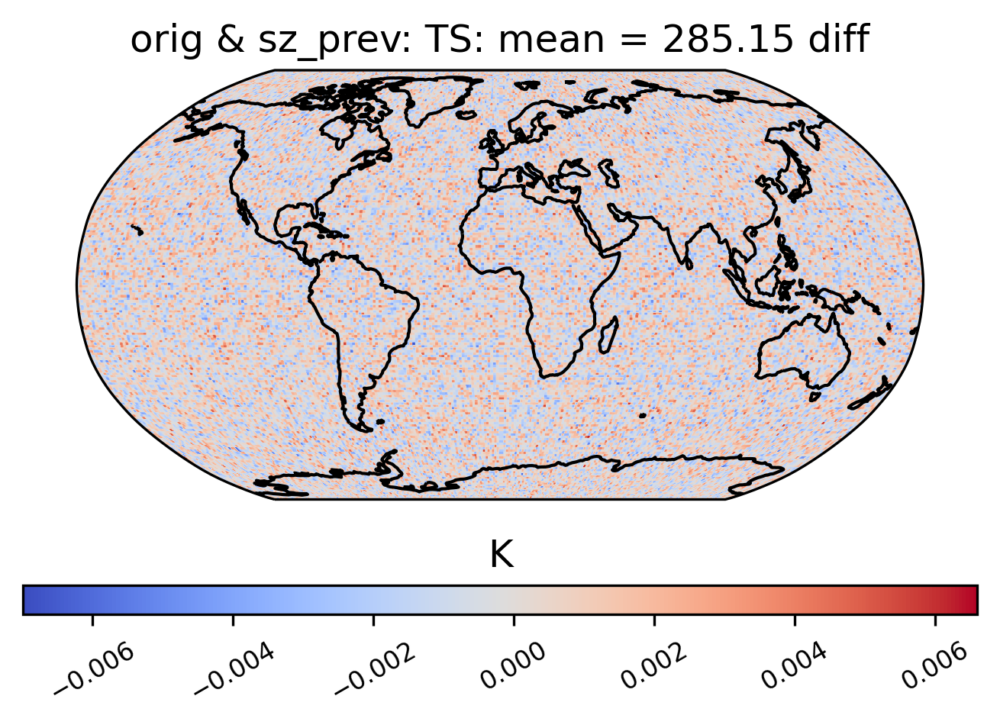

In [12]:
# diff between mean
ldcpy.plot(
    sm_col_ts_sz,
    "TS",
    sets=["orig", "sz_prev"],
    calc="mean",
    calc_type="diff",
)

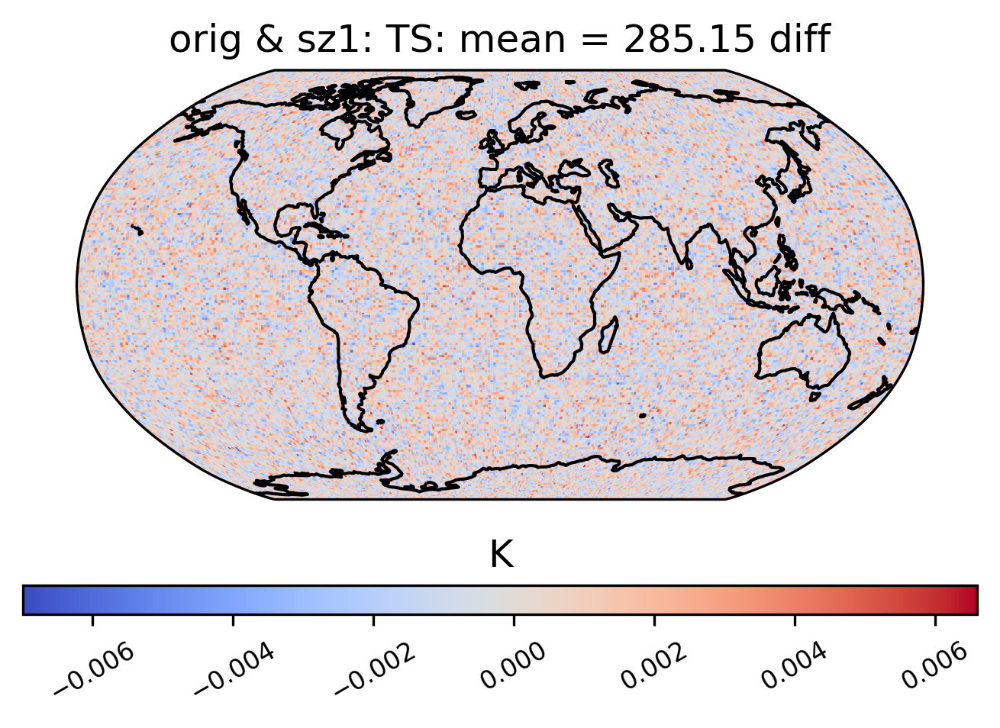

In [13]:
# diff between mean
ldcpy.plot(
    sm_col_ts_sz,
    "TS",
    sets=["orig", "sz1"],
    calc="mean",
    calc_type="diff",
)

In [ ]:
# mean
ldcpy.plot(
    sm_col_ts_sz,
    "TS",
    sets=["orig", "sz_prev", "sz_new"],
    calc="mean",
)

In [ ]:
import os
os.listdir("/glade/p/cisl/asap/CAM_lossy_test_data_31")

In [ ]:
from netCDF4 import Dataset
#Can I open a netdcf file with a filter?
fname_o =  "/glade/scratch/abaker/comp/orig/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc"
fname_c =  "/glade/scratch/abaker/comp/orig/zfp_precision_16.nc"

fo= Dataset(fname_o, "r", format="NETCDF4")
fc= Dataset(fname_c, "r", format="NETCDF4")

ts_o = fo.variables["TS"]                                              
ts_c = fc.variables["TS"]                                              
os.environ["HDF5_PLUGIN_PATH"]

In [ ]:
col_ts_zfp = ldcpy.open_datasets("cam-fv",["TS"],
                                 ["/glade/scratch/abaker/comp/orig/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.TS.200601-201012.nc", 
                                   "/glade/scratch/abaker/comp/orig/zfp_pc.nc",
                                   "/glade/scratch/abaker/comp/orig/zfp_p16_undone_d5.nc"], 
                                 ["orig", "zfp_p16", "zfp_p16_hdf"])
    

In [ ]:
ldcpy.compare_stats(
    col_ts_zfp.isel(time=10),
    "TS",
    [
        "orig",
        "zfp_p16","zfp_p16_hdf"
    ]
)

In [ ]:
## CCN3  #####
col_ccn3 = ldcpy.open_datasets(
    "cam-fv",
    ["CCN3"],
    [
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/orig/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.CCN3.200601-201012.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/bg/bg_3/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.CCN3.200601-201012.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/sz/sz2_1_12ROn0.005/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.CCN3.200601-201012.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/zfp_all/zfp_p_12/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.CCN3.200601-201012.nc",               
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/sz1.4/sz2_1_12ROn0.0005/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.CCN3.200601-201012.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/sz1.4/sz2_1_12ROn0.005/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.CCN3.200601-201012.nc",

        "/glade/p/cisl/asap/CAM_lossy_test_data_31/bg/bg_5/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.CCN3.200601-201012.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/sz/sz2_1_12ROn0.0005/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.CCN3.200601-201012.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/zfp_all/zfp_p_16/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.CCN3.200601-201012.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/sz1.4/sz2_1_12ROn5e-05/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.CCN3.200601-201012.nc",

    ],
    [  "orig",
        "bg_3", "sz_005", "zfp_p12", "sz14_0005","sz14_005",
     "bg_5", "sz_0005", "zfp_p16", "sz14_5e5"

    ],
)

In [ ]:
# CCN3 (level = 10 time = 10)
ldcpy.compare_stats(
    col_ccn3.isel(time=10, lev=10),
    "CCN3",
    [
        "orig",
        "bg_3", "sz_005", "zfp_p12","sz14_0005", "sz14_005"
    ]
)

In [ ]:
# diff between mean
ldcpy.plot(
    col_ccn3,
    "CCN3",
    sets=["orig", "bg_3", "zfp_p12"],
    calc="mean",
    calc_type="diff",
)

In [ ]:
# diff between mean
ldcpy.plot(
    col_ccn3,
    "CCN3",
    sets=["orig", "sz14_005"],
    calc="mean",
    calc_type="diff", lev = 10, start=10, end=10
)

In [ ]:
# CCN3 (level = 10 time = 10)
ldcpy.compare_stats(
    col_ccn3.isel(time=10, lev=10),
    "CCN3",
    [
        "orig",
        "bg_5", "sz_0005", "zfp_p16",
    ]
)

In [ ]:
## TS  #####
col_ts = ldcpy.open_datasets(
    "cam-fv",
    ["TS"],
    [
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/orig/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.TS.20060101-20071231.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/bg/bg_5/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.TS.20060101-20071231.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/sz/sz2_1_12ROn0.05/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.TS.20060101-20071231.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/zfp_all/zfp_p_18/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.TS.20060101-20071231.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/sz1.4/sz2_1_12ROn0.01/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.TS.20060101-20071231.nc",

          "/glade/p/cisl/asap/CAM_lossy_test_data_31/bg/bg_6/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.TS.20060101-20071231.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/sz/sz2_1_12ROn0.01/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.TS.20060101-20071231.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/zfp_all/zfp_p_22/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.TS.20060101-20071231.nc",        
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/sz1.4/sz2_1_12ROn0.005/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.TS.20060101-20071231.nc",

        
    ],
    [  "orig", 
       "bg_5", "sz_05", "zfp_p18","sz14_01",
        "bg_6", "sz_01", "zfp_p22", "sz14_005"

    ],
)

In [ ]:
ldcpy.compare_stats(
    col_ts.isel(time=10),
    "TS",
    [
        "orig",
        "bg_5", "sz_05", "zfp_p18","sz14_01"
    ]
)

In [ ]:
ldcpy.compare_stats(
    col_ts.isel(time=10),
    "TS",
    [
        "orig",
        "bg_6", "sz_01", "zfp_p22",
    ]
)

In [ ]:
# mean
ldcpy.plot(
    col_ts,
    "TS",
    sets=["orig", "bg_5", "sz_05", "zfp_p18", "sz14_01"],
    calc="mean",
)

In [ ]:
# mean
ldcpy.plot(
    col_ts,
    "TS",
    sets=["orig", "bg_5", "sz_05", "zfp_p18", "sz14_01"],
    calc="mean", calc_type="diff"
)

In [ ]:
## LHFLX  #####
col_lhflx = ldcpy.open_datasets(
    "cam-fv",
    ["LHFLX"],
    [
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/orig/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.LHFLX.200601-201012.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/bg/bg_4/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.LHFLX.200601-201012.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/sz/sz2_1_12ROn0.1/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.LHFLX.200601-201012.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/zfp_all/zfp_p_14/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.LHFLX.200601-201012.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/sz1.4/sz2_1_12ROn0.01/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h0.LHFLX.200601-201012.nc",

    ],
    [  "orig",
        "bg_4",
        "sz_1",
        "zfp_p14", "sz14_01",
     
    ],
)

In [ ]:
ldcpy.compare_stats(
    col_lhflx.isel(time=10),
    "LHFLX",
    [
        "orig",
        "bg_4", "sz_1", "zfp_p14","sz14_01"
    ]
)

In [ ]:
# mean
ldcpy.plot(
    col_lhflx,
    "LHFLX",
    sets=["orig", "bg_4", "zfp_p14"],
    calc="mean", calc_type="diff"
)

In [ ]:
# mean
ldcpy.plot(
    col_lhflx,
    "LHFLX",
    sets=["orig", "sz_1"],
    calc="mean", calc_type="diff"
)

In [ ]:
# mean
ldcpy.plot(
    col_lhflx,
    "LHFLX",
    sets=["orig",  "sz14_01"],
    calc="mean", calc_type="diff"
)

In [ ]:
## PRECT-SZ  #####
col_prect_sz = ldcpy.open_datasets(
    "cam-fv",
    ["PRECT"],
    [
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/orig/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
        "/glade/scratch/abaker/comp/sz/sz2_1_12PwR0.001/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
        "/glade/scratch/abaker/comp/sz/sz2_1_12ROn0.001/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
         "/glade/scratch/abaker/comp/sz/sz2_1_12PwR0.0001/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
        "/glade/scratch/abaker/comp/sz/sz2_1_12ROn0.0001/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
         "/glade/scratch/abaker/comp/sz/sz2_1_12PwR1e-05/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
        "/glade/scratch/abaker/comp/sz/sz2_1_12ROn1e-05/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
         "/glade/scratch/abaker/comp/sz/sz2_1_12PwR0.1/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
        "/glade/scratch/abaker/comp/sz/sz2_1_12ROn0.1/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
         "/glade/scratch/abaker/comp/sz/sz2_1_12PwR0.01/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
        "/glade/scratch/abaker/comp/sz/sz2_1_12ROn0.01/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",

        "/glade/scratch/abaker/comp/sz1.4/sz2_1_12ROn0.1/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
        "/glade/scratch/abaker/comp/sz1.4/sz2_1_12ROn0.01/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
        "/glade/scratch/abaker/comp/sz1.4/sz2_1_12ROn0.001/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
        "/glade/scratch/abaker/comp/sz1.4/sz2_1_12ROn0.0001/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
        "/glade/scratch/abaker/comp/sz1.4/sz2_1_12ROn1e-05/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",

    ],
    [  "orig", 
       "sz_pwr_001", "sz_001",
       "sz_pwr_0001", "sz_0001",
         "sz_pwr_1e5", "sz_1e5",
 "sz_pwr_1", "sz_1", "sz_pwr_01", "sz_01",
     "sz14_1", "sz14_01", "sz14_001", "sz14_0001", "sz14_1e5"
    ],
)

In [ ]:
ldcpy.compare_stats(
    col_prect_sz.isel(time=10),
    "PRECT",
    [
        "orig",
        "sz14_1", "sz_1",
         "sz14_01", "sz_01",
         "sz14_001", "sz_001",

    ],
)

In [ ]:
ldcpy.compare_stats(
    col_prect_sz.isel(time=10),
    "PRECT",
    [
        "orig",
        "sz_pwr_1", "sz_1",
         "sz_pwr_01", "sz_01",
    ],
)

In [ ]:
ldcpy.compare_stats(
    col_prect_sz.isel(time=10),
    "PRECT",
    [
        "orig",
        "sz_pwr_001", "sz_001",
         "sz_pwr_0001", "sz_0001",
         "sz_pwr_1e5", "sz_1e5",
    ]
)

In [ ]:
## PRECT  #####
col_prect = ldcpy.open_datasets(
    "cam-fv",
    ["PRECT"],
    [
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/orig/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/bg/bg_3/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/sz/sz2_1_12ROn0.05/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/zfp_all/zfp_p_12/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/sz1.4/sz2_1_12ROn0.005/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",

        "/glade/p/cisl/asap/CAM_lossy_test_data_31/bg/bg_5/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
                "/glade/p/cisl/asap/CAM_lossy_test_data_31/sz/sz2_1_12ROn0.005/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/zfp_all/zfp_p_18/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.PRECT.20060101-20071231.nc"
    ],
    [  "orig", 
       "bg_3", "sz_05", "zfp_p12", "sz14_005",
        "bg_5", "sz_005", "zfp_p18",

    ],
)

In [ ]:
ldcpy.compare_stats(
    col_prect.isel(time=10),
    "PRECT",
    [
        "orig",
        "bg_3", "sz_05", "zfp_p12", "sz14_005",
    ]
)

In [ ]:
ldcpy.compare_stats(
    col_prect.isel(time=10),
    "PRECT",
    [
        "orig",
        "bg_3", "sz_05", "zfp_p12", "bg_5", "sz_005", "zfp_p18",
    ]
)

In [ ]:
## Z500  #####
col_z500 = ldcpy.open_datasets(
    "cam-fv",
    ["Z500"],
    [
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/orig/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.Z500.20060101-20071231.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/bg/bg_4/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.Z500.20060101-20071231.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/sz/sz2_1_12ROn0.005/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.Z500.20060101-20071231.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/zfp_all/zfp_p_16/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.Z500.20060101-20071231.nc",
        
          "/glade/p/cisl/asap/CAM_lossy_test_data_31/bg/bg_5/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.Z500.20060101-20071231.nc",
           "/glade/p/cisl/asap/CAM_lossy_test_data_31/sz/sz2_1_12ROn0.1/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.Z500.20060101-20071231.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/zfp_all/zfp_p_20/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.Z500.20060101-20071231.nc",
        "/glade/p/cisl/asap/CAM_lossy_test_data_31/sz1.4/sz2_1_12ROn0.01/b.e11.BRCP85C5CNBDRD.f09_g16.031.cam.h1.Z500.20060101-20071231.nc"

    ],
    [  "orig", 
       "bg_4", "sz_005", "zfp_p16", 
        "bg_5", "sz_1", "zfp_p20", "sz14_01"

    ],
)

In [ ]:
ldcpy.compare_stats(
    col_z500.isel(time=10),
    "Z500",
    [
        "orig",
        "bg_4", "sz_005", "zfp_p16",
    ]
)

In [ ]:
ldcpy.compare_stats(
    col_z500.isel(time=10),
    "Z500",
    [
        "orig",
        "bg_5", "sz_1", "zfp_p20","sz14_01"
    ]
)

In [ ]:
# mean
ldcpy.plot(
    col_z500,
    "Z500",
    sets=["orig", "bg_5", "sz_1", "zfp_p20", "sz14_01"],
    calc="mean",
)

In [ ]:
# mean
ldcpy.plot(
    col_z500,
    "Z500",
    sets=["orig", "bg_5", "sz_1", "zfp_p20", "sz14_01"],
    calc="mean", calc_type="diff"
)

In [ ]:
# Disconnect when finished
cluster.close()
client.close()